# Documentation

OSMNX  
* Github: https://github.com/gboeing/osmnx
* Doc: https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=route#module-osmnx.graph

In [1]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import IFrame
import pandas as pd
import folium
from folium.plugins import MarkerCluster

%matplotlib inline

In [2]:
manhattan = 'Manhattan, New York City, New York, USA'
simple_graph = ox.graph_from_place(manhattan, network_type='drive')
full_graph = ox.graph_from_place(manhattan, network_type='drive', simplify=False)

/Users/noah/opt/anaconda3/envs/ox/lib/python3.10/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))
/Users/noah/opt/anaconda3/envs/ox/lib/python3.10/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))


In [3]:
#for node in full_graph.nodes():
#   if ox.simplification._is_endpoint(full_graph, node, strict=True):
#        nx.set_node_attributes(full_graph, 'true', 'intersection')
#    else: nx.set_node_attributes(full_graph, 'false', 'intersection')

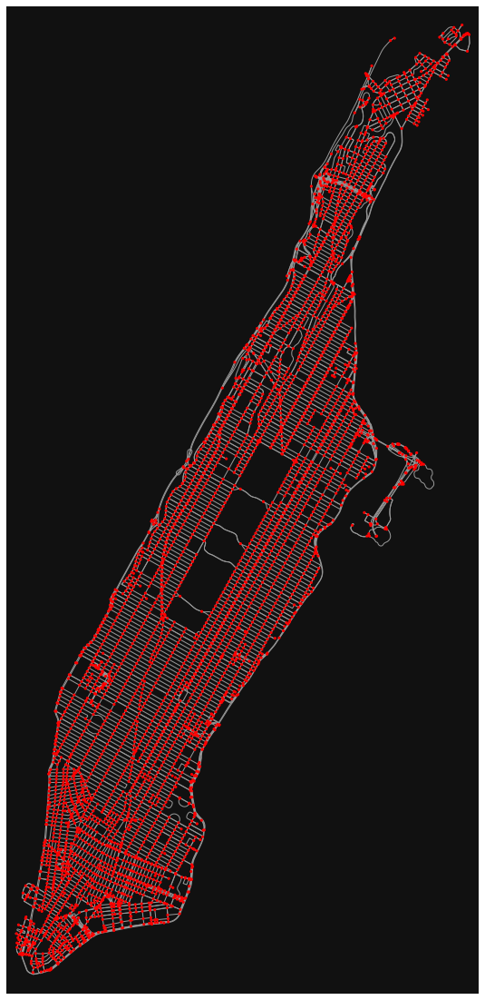

In [4]:
fig, ax = ox.plot_graph(simple_graph, node_color="r", node_size=10, figsize=(10, 20))
#fig2, ax2 = ox.plot_graph(full_graph, node_color="r", node_size=10, figsize=(10, 20))

# Display Graph as GeoPandas GeoDataFrames

In [5]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(simple_graph)
#gdf_nodes2, gdf_edges2 = ox.graph_to_gdfs(full_graph)

In [6]:
# Nodes
# simple graph: 4580
# full graph: 28013
#gdf_nodes2.head(30)

In [7]:
# Edges
# simple graph: 9866
# full graph: 37377
#gdf_edges2

# Add Speed Limits and Travel Time to Edges

In [8]:
simple_graph = ox.add_edge_speeds(simple_graph)
simple_graph = ox.add_edge_travel_times(simple_graph)

#full_graph = ox.add_edge_speeds(full_graph)
#full_graph = ox.add_edge_travel_times(full_graph)

# Save Graph to graphml file 

In [9]:
ox.save_graphml(simple_graph, filepath="./data/graph/simple.graphml")
#ox.save_graphml(full_graph, filepath="./data/graph/full.graphml")

# Plot Graph in Map

In [15]:
m1 = ox.plot_graph_folium(simple_graph, fit_bounds=True, popup_attribute="name", weight=2, color="#333333")
filepath = "data/graph.html"
m1.save(filepath)
m1

# Print shortest path into graph

In [11]:

# use networkx to calculate the shortest path between two nodes
origin = 589927965
destination = 589928033
route = nx.shortest_path(simple_graph, origin, destination, weight="travel_time")

# plot the route with folium
# like above, you can pass keyword args along to folium PolyLine to style the lines
m2 = ox.plot_route_folium(simple_graph, route, route_map=m1, popup_attribute="length", weight=3)
count = 0
#for node in route:
#    node_x = full_graph.nodes().get(node).get('x')
#    node_y = full_graph.nodes().get(node).get('y')
#    print(node, node_x, node_y)
#    folium.Marker([node_x,node_y], popup = f"{node}").add_to(m2)


print(count)
filepath = "data/route_graph.html"
m2.save(filepath)
m2

0


# Get nodes of route

In [12]:
len(route)

11

# TODO: Compute Nearest Edge/Node For Coordinates

In [13]:
ox.distance.nearest_nodes(full_graph, -73.982155, 40.767937, return_dist=True)

(1825841679, 16.649683700951453)

# Assign weights to nodes

In [14]:
# To do this use the following:
#import networkx as nx
#import osmnx as ox
#G = ox.graph_from_place('Piedmont, CA, USA', network_type='drive')

# create node weights
#w = {k: 3 if v == 'turning_circle' else 1 for k, v in G.nodes(data='highway')}
#nx.set_node_attributes(G, w, 'weight')